# Project 1

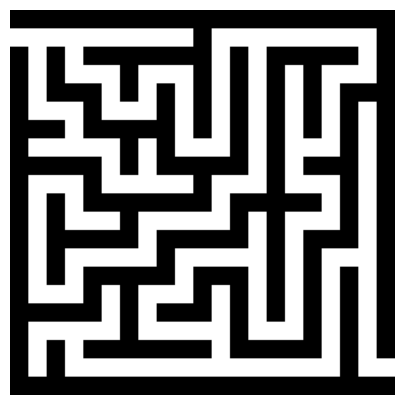

In [68]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image
import numpy as np

input_file = 'maze1.png'
maze = Image.open(input_file)
    
plt.figure(figsize=(5, 5))
plt.imshow(maze)
plt.axis('off')
plt.show()

In [69]:
from PIL import Image
import numpy as np
import cv2
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

def get_maze_array(image_file):
    # Open the image file and convert it to grayscale
    maze = Image.open(image_file).convert('L')
    
    # Get the size of the maze image
    cols, rows = maze.size
    
    # Convert the image to a binary matrix
    binary_matrix = maze.point(lambda p: p > 127 and 1)
    
    # Resize the binary matrix (optional)
    binary_matrix = binary_matrix.resize((cols//2, rows//2), Image.NEAREST)
    
    # Get the new size of the resized matrix
    cols, rows = binary_matrix.size
    
    # Convert the binary matrix to a numpy array
    maze_array = np.array(binary_matrix)
    
    return maze_array
    
mazearray = get_maze_array('maze.png')
print(mazearray)


[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [70]:

def find_start_end_points(maze_array):
    rows, cols = maze_array.shape
    start = None
    for i in range(rows):
        for j in range(cols):
            if maze_array[i, j] == 1:
                start = (i, j)
                break
        if start:
            break

    end = None
    for i in range(rows-1, -1, -1):
        for j in range(cols-1, -1, -1):
            if maze_array[i, j] == 1:
                end = (i, j)
                break
        if end:
            break

    return start, end


start, end = find_start_end_points(mazearray)
print(f"Maze size: {mazearray.shape}")
print(f"Start point: {start}")
print(f"End point: {end}")


Maze size: (205, 205)
Start point: (5, 0)
End point: (199, 204)


In [71]:

class MazeMDP:
    def __init__(self, maze, start, end, gamma=0.995):
        self.maze = maze
        self.start = start
        self.end = end
        self.gamma = gamma
        self.rows, self.cols = maze.shape
        self.actions = [(0, 1), (0, -1), (1, 0), (-1, 0)]
        self.states = [(i, j) for i in range(self.rows) for j in range(self.cols) if maze[i, j] == 1]

    def is_valid(self, state):
        i, j = state
        return 0 <= i < self.rows and 0 <= j < self.cols and self.maze[i, j] == 1

    def next_state(self, state, action):
        i, j = state
        di, dj = action
        next_state = (i + di, j + dj)
        return next_state if self.is_valid(next_state) else state

    def reward(self, state, action, next_state):
        if next_state == self.end:
            return 100
        elif next_state == state:
            return -5
        else:
            return -0.1

In [72]:

def value_iteration(mdp, eps=1e-6, max_iter=5000):
    Value = {state: 0 for state in mdp.states}
    for it in range(max_iter):
        delta = 0
        newValue = Value.copy()
        for state in mdp.states:
            if state == mdp.end:
                continue
            q_values = []
            for action in mdp.actions:
                next_state = mdp.next_state(state, action)
                reward = mdp.reward(state, action, next_state)
                q_values.append(reward + mdp.gamma * Value[next_state])
            newValue[state] = max(q_values)
            delta = max(delta, abs(newValue[state] - Value[state]))
        Value = newValue
        if delta < eps:
            print(f"Value iteration converged after {it + 1} iterations")
            break
    return Value


In [73]:

def extract_policy(mdp, Value):
    policy = {}
    for state in mdp.states:
        if state == mdp.end:
            policy[state] = None
            continue
        best_a = None
        best_q = -1e9
        for i, action in enumerate(mdp.actions):
            next_state = mdp.next_state(state, action)
            reward = mdp.reward(state, action, next_state)
            q = reward + mdp.gamma * Value[next_state]
            if q > best_q:
                best_q = q
                best_a = i
        policy[state] = best_a
    return policy

def generate_path(mdp, policy):
    path = [mdp.start]
    state = mdp.start
    for _ in range(len(mdp.states) * 5):
        if state == mdp.end:
            break
        a_idx = policy.get(state)
        if a_idx is None:
            break
        action = mdp.actions[a_idx]
        next_state = mdp.next_state(state, action)
        if next_state == state:
            for alt in mdp.actions:
                next_state_try = mdp.next_state(state, alt)
                if next_state_try != state:
                    next_state = next_state_try
                    break
        state = next_state
        path.append(state)
    return path

In [74]:

def create_solution_image(maze, path, start, end, output_path):
    color_maze = np.zeros((maze.shape[0], maze.shape[1], 3), dtype=np.uint8)
    color_maze[maze == 0] = [0, 0, 0]
    color_maze[maze == 1] = [255, 255, 255]

    for i in range(len(path)-1):
        y1, x1 = path[i]
        y2, x2 = path[i+1]
        cv2.line(color_maze, (x1, y1), (x2, y2), (0, 0, 255), 3)

    cv2.circle(color_maze, (start[1], start[0]), 3, (0, 255, 0), -1)
    cv2.circle(color_maze, (end[1], end[0]), 3, (255, 0, 0), -1)

    plt.figure(figsize=(5, 5))
    plt.imshow(cv2.cvtColor(color_maze, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title('Solved Maze')
    plt.savefig(output_path, dpi=200)
    plt.show()
    return color_maze

def animate_path(maze, path, save_gif=False):
    """Show animation inside Jupyter Notebook"""
    color_maze = np.zeros((maze.shape[0], maze.shape[1], 3), dtype=np.uint8)
    color_maze[maze == 0] = [0, 0, 0]
    color_maze[maze == 1] = [255, 255, 255]

    fig, ax = plt.subplots(figsize=(5, 5))
    im = ax.imshow(cv2.cvtColor(color_maze, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    def update(i):
        frame = color_maze.copy()
        for k in range(i):
            if k < len(path)-1:
                y1, x1 = path[k]
                y2, x2 = path[k+1]
                cv2.line(frame, (x1, y1), (x2, y2), (0, 0, 255), 3)
        im.set_array(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        return [im]

    ani = animation.FuncAnimation(fig, update, frames=len(path), interval=30, blit=True)

    plt.close(fig)
    display(HTML(ani.to_jshtml()))

    return ani

Start: (5, 0), End: (199, 204)
Value iteration converged after 1834 iterations
Path length: 775


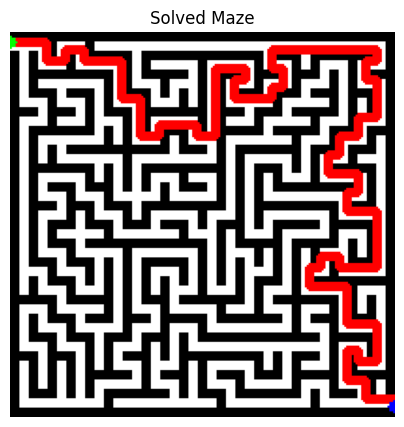

In [76]:
if __name__ == "__main__":
    input_file = "maze.png"
    output_file = "solvedmaze.png"

    maze = get_maze_array(input_file)
    start, end = find_start_end_points(maze)
    print(f"Start: {start}, End: {end}")

    mdp = MazeMDP(maze, start, end, gamma=0.99)
    Value = value_iteration(mdp)
    policy = extract_policy(mdp, Value)
    path = generate_path(mdp, policy)

    print(f"Path length: {len(path)}")
    create_solution_image(maze, path, start, end, output_file)
    animate_path(maze, path)
